# Dependencies and files

## Install dependencies

## Imports

In [92]:
import warnings
import scanpy as sc
import anndata as an
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import os

import time
from tqdm.notebook import tqdm
import requests

sc.settings.set_figure_params(dpi=80)
#sc.set_figure_params(facecolor="white", figsize=(8, 8))
warnings.simplefilter(action='ignore', category=FutureWarning)
sc.settings.verbosity = 3

# Global variables

In [93]:
layers = ['L1', 'L2', 'L3', 'L4', 'L5', "L6", 'WM']

In [94]:
cluster_color = ['red', 'yellow', 'orange', 'green', 'purple', 'blue', 'olive', 'pink', 'brown']

## Load files

### DE results

In [95]:
ancova_labels = pd.read_csv('./results/human_clusters_ancova_01_cos_all_8.csv', index_col=0)['0'].sort_values()
ancova_labels

EIF1B     0
ENC1      0
ETFB      0
DAAM1     0
TMOD1     0
         ..
CNKSR2    7
ALCAM     7
EIF4G3    7
PTPRK     7
KRT222    7
Name: 0, Length: 100, dtype: int64

## Load normalized pseudobulks

### Adult humans

In [96]:
dir_path = '../data/pseudobulks/'

In [97]:
os.listdir(dir_path)

['4spe_pb_mean_filt.h5ad',
 '4spe_pb_mean_filt_nor_mean.h5ad',
 'pb_age.h5ad',
 'pb_age_sample_norm.h5ad',
 'pb_mammals.h5ad',
 'pb_mammals_filtered.h5ad',
 'pb_mammals_samplenorm_mean.h5ad',
 'pb_mammals_samplenorm_mean_filtered.h5ad',
 'pb_mammals_samplenorm_zscore.h5ad']

In [98]:
adata_pb_adult = sc.read_h5ad(dir_path + 'pb_age.h5ad')
adata_pb_adult = adata_pb_adult[adata_pb_adult.obs.condition == 'spatial_libd_human', :]
#adata_pb_norm_mean.var = anova_res
adata_pb_adult

View of AnnData object with n_obs × n_vars = 76 × 17919
    obs: 'layer', 'sample_id', 'psbulk_n_cells', 'psbulk_counts', 'condition'
    var: 'feature_types', 'mt', 'hb', 'ribo'
    layers: 'psbulk_props'

### Mammals

In [99]:
pb_dir_path = '../data/pseudobulks/'

In [100]:
adata_pb_norm = sc.read_h5ad(pb_dir_path + 'pb_mammals_samplenorm_mean_filtered.h5ad')
#adata_pb_norm_mean.var = anova_res
adata_pb_norm

AnnData object with n_obs × n_vars = 89 × 5390
    obs: 'layer', 'sample_id', 'psbulk_n_cells', 'psbulk_counts', 'condition', 'lib_size', 'log_lib_size'
    var: 'feature_types', 'mt', 'hb', 'ribo'
    uns: 'log1p', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'psbulk_props'

In [101]:
background_genes = adata_pb_norm.var_names.tolist()
len(background_genes)

5390

## Let's normalize adult samples

First we need to notmalize on library size using the same genes

In [102]:
# filtered genes
adata_pb_mamm_filtered = sc.read_h5ad(dir_path + 'pb_mammals_filtered.h5ad')
#adata_pb_norm_mean.var = anova_res
filtered_genes = adata_pb_mamm_filtered.var_names
adata_pb_mamm_filtered

AnnData object with n_obs × n_vars = 89 × 9208
    obs: 'layer', 'sample_id', 'psbulk_n_cells', 'psbulk_counts', 'condition', 'lib_size', 'log_lib_size'
    var: 'feature_types', 'mt', 'hb', 'ribo'
    layers: 'psbulk_props'

In [103]:
adata_merged = an.concat([adata_pb_mamm_filtered, adata_pb_adult], merge='same')
adata_merged

AnnData object with n_obs × n_vars = 165 × 9064
    obs: 'layer', 'sample_id', 'psbulk_n_cells', 'psbulk_counts', 'condition'
    var: 'feature_types', 'mt', 'hb', 'ribo'
    layers: 'psbulk_props'

In [104]:
sc.pp.normalize_total(adata_merged, target_sum=1e4)
sc.pp.log1p(adata_merged)

normalizing counts per cell
    finished (0:00:00)


computing PCA
    with n_comps=34


    finished (0:00:00)


d:\Projects\spatialMPFC\venv\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
d:\Projects\spatialMPFC\venv\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


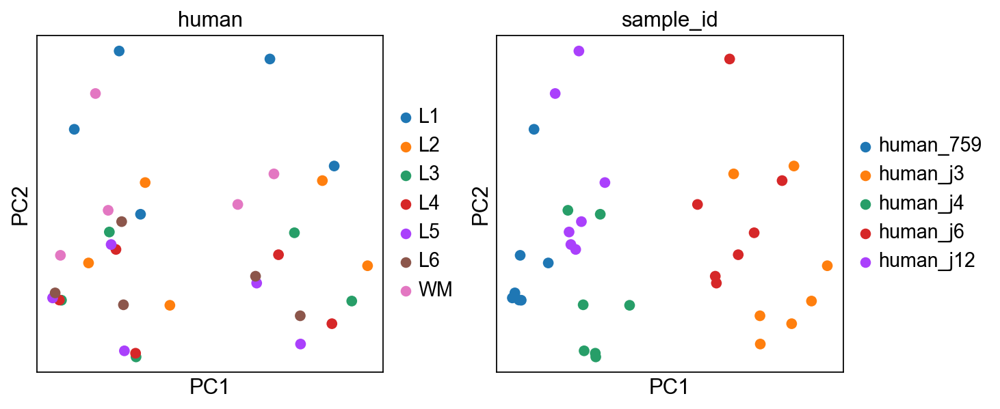

computing PCA
    with n_comps=25
    finished (0:00:00)


d:\Projects\spatialMPFC\venv\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
d:\Projects\spatialMPFC\venv\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


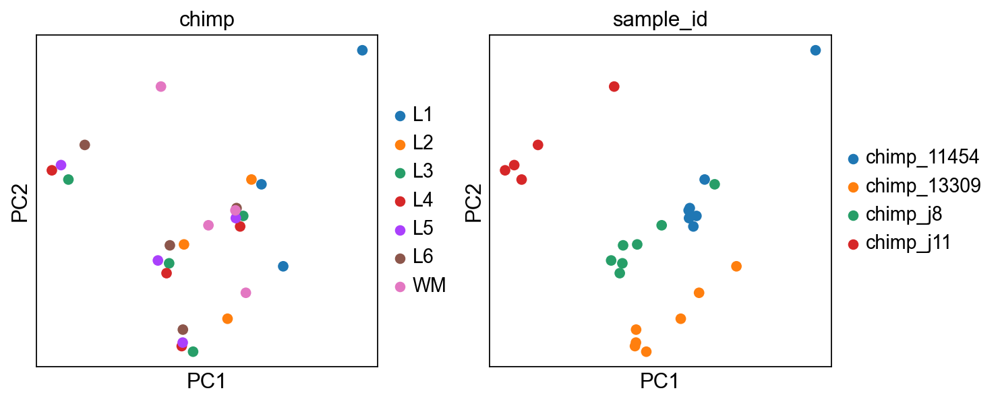

computing PCA
    with n_comps=27
    finished (0:00:00)


d:\Projects\spatialMPFC\venv\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
d:\Projects\spatialMPFC\venv\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


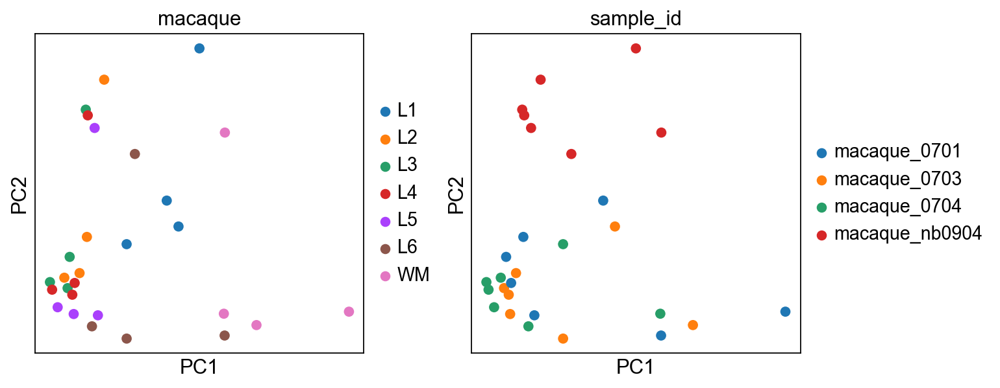

computing PCA
    with n_comps=50
    finished (0:00:00)


d:\Projects\spatialMPFC\venv\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
d:\Projects\spatialMPFC\venv\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


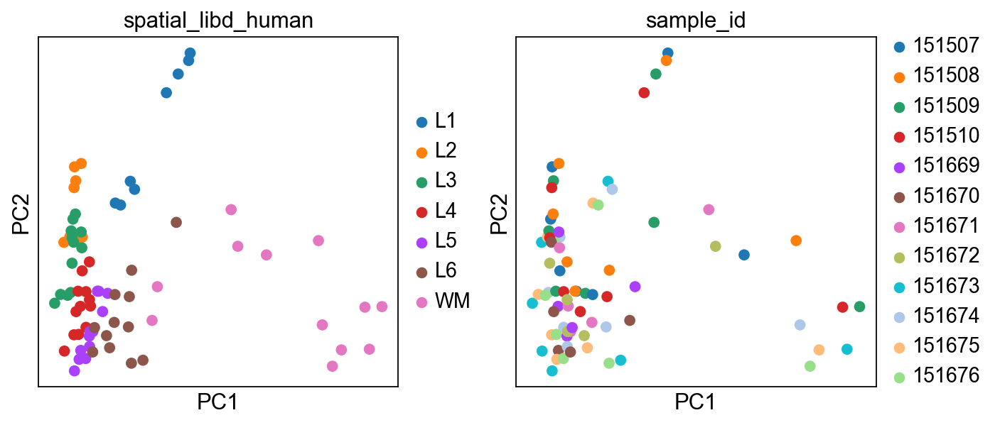

In [105]:
for cond in ['human', 'chimp', 'macaque', 'spatial_libd_human']:
    adata_cond = adata_merged[adata_merged.obs.condition == cond, :].copy()
    sc.pp.pca(adata_cond, return_info=False)
    sc.pl.pca(adata_cond, color=['layer', 'sample_id'], size=200, ncols=2, title=cond)

In [106]:
def subtract_mean(adata):
    # calculate mean gene expr for each sample
    gene_mean_list = []
    sample_layer_list = adata.obs.sample_id.unique().tolist()
    for sample in sample_layer_list:
        gene_mean_list.append(adata[adata.obs.sample_id == sample].X.mean(axis=0).reshape(-1, 1))
    # convert to DataFrame
    gene_mean_df = pd.DataFrame(np.concatenate(gene_mean_list, axis=1), columns=sample_layer_list, index=adata.var_names)
    gene_mean_df.head()
    
    # subtract mean and return adata
    for sample in sample_layer_list:
        columns = adata.obs[adata.obs.sample_id == sample].index.to_list()
        for column in columns:
            adata[column].X = adata[column].X - gene_mean_df.loc[:, sample].values
    return adata

In [107]:
adata_pb_merged_norm = subtract_mean(adata_merged)
adata_pb_merged_norm = adata_pb_merged_norm[:, adata_pb_merged_norm.var_names.intersection(background_genes)]
adata_pb_merged_norm

View of AnnData object with n_obs × n_vars = 165 × 5300
    obs: 'layer', 'sample_id', 'psbulk_n_cells', 'psbulk_counts', 'condition'
    var: 'feature_types', 'mt', 'hb', 'ribo'
    uns: 'log1p'
    layers: 'psbulk_props'

computing PCA
    with n_comps=34


    finished (0:00:00)


d:\Projects\spatialMPFC\venv\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
d:\Projects\spatialMPFC\venv\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


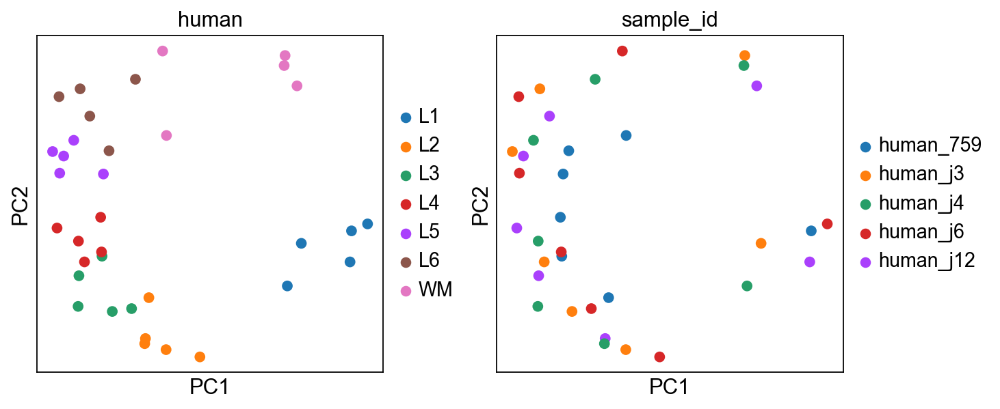

computing PCA
    with n_comps=25
    finished (0:00:00)


d:\Projects\spatialMPFC\venv\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
d:\Projects\spatialMPFC\venv\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


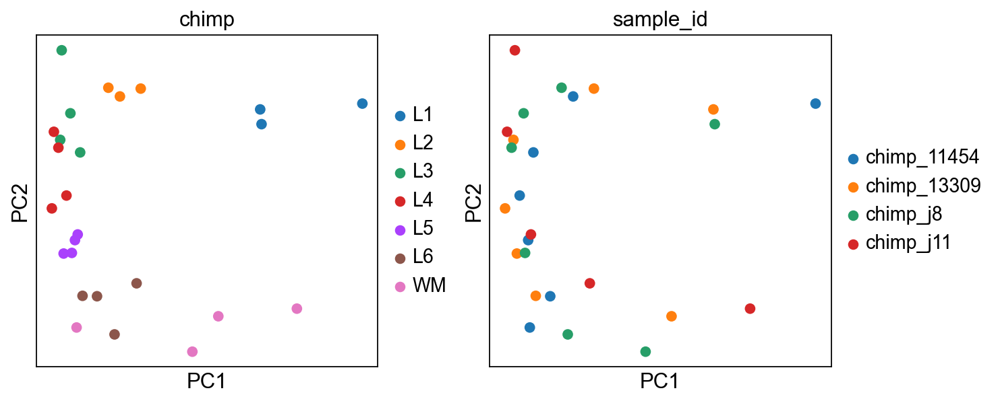

computing PCA
    with n_comps=27
    finished (0:00:00)


d:\Projects\spatialMPFC\venv\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
d:\Projects\spatialMPFC\venv\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


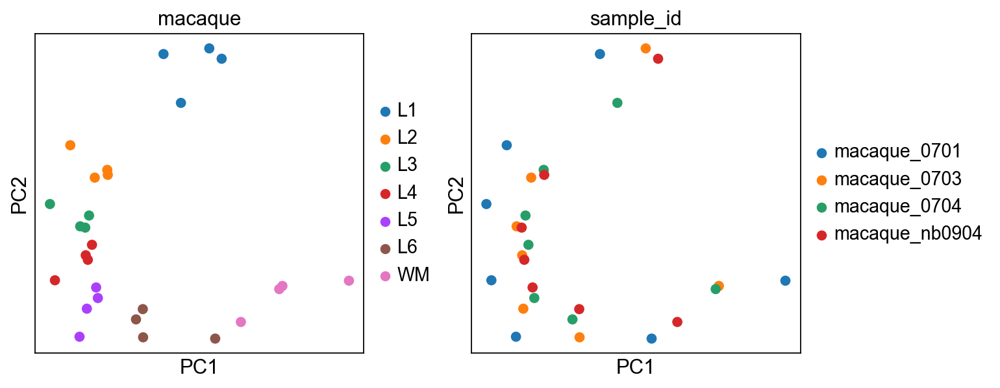

computing PCA
    with n_comps=50
    finished (0:00:00)


d:\Projects\spatialMPFC\venv\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
d:\Projects\spatialMPFC\venv\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


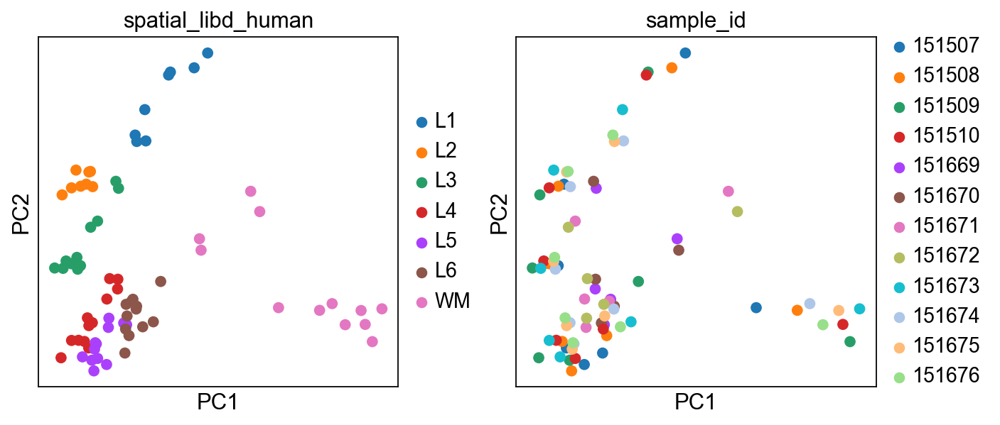

In [108]:
for cond in ['human', 'chimp', 'macaque', 'spatial_libd_human']:
    adata_cond = adata_pb_merged_norm[adata_pb_merged_norm.obs.condition == cond, :].copy()
    sc.pp.pca(adata_cond, return_info=False)
    sc.pl.pca(adata_cond, color=['layer', 'sample_id'], size=200, ncols=2, title=cond)

computing PCA
    with n_comps=50
    finished (0:00:00)


d:\Projects\spatialMPFC\venv\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
d:\Projects\spatialMPFC\venv\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


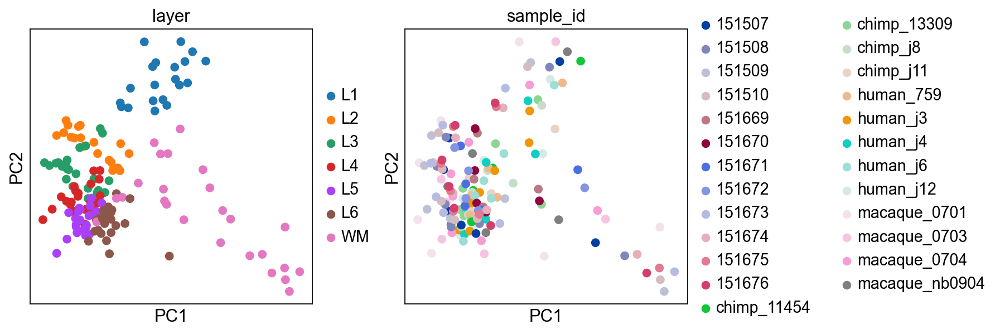

In [109]:
sc.pp.pca(adata_pb_merged_norm)
sc.pl.pca(adata_pb_merged_norm, color=['layer', 'sample_id'], size=200, ncols=2)

## Specie-specific genes

In [110]:
model_res = pd.read_csv('results/gene_selection_df.csv', index_col=0)
model_res.head()

,human,chimp,macaque
AACS,0.001206,0.014287,0.318736
AAGAB,0.731575,0.661344,0.024143
AAK1,0.000658,0.699175,0.069657
AAMP,0.762617,0.530339,0.947528
AAR2,0.312623,0.436571,0.343371


In [111]:
import pickle
with open("results/ancova_perm_res.pkl", "rb") as file:
    ancova_results = pickle.load(file)

In [112]:
# import pickle
# with open("./results/specie_specific_genes_tr50.pkl", "rb") as file:
#     genes_dict77 = pickle.load(file)

In [113]:
pval_tr = 0.01
sign_genes = {key:value[value['p-value'] < pval_tr].index for key, value in ancova_results.items()}
sign_genes

{'human-chimp': Index(['ABI2', 'ABLIM3', 'ACTN2', 'ADAM15', 'ADGRB2', 'ADGRL1', 'AK1', 'AKT3',
        'ALCAM', 'ALKBH5',
        ...
        'WDR7', 'WLS', 'YES1', 'YWHAE', 'ZBTB17', 'ZBTB18', 'ZBTB46', 'ZCCHC17',
        'ZMYND8', 'ZNF706'],
       dtype='object', length=322),
 'human-macaque': Index(['AAGAB', 'AARS1', 'AATK', 'ABAT', 'ABCD4', 'ABHD10', 'ABHD6', 'ABHD8',
        'ABLIM3', 'ABT1',
        ...
        'ZNF140', 'ZNF184', 'ZNF189', 'ZNF304', 'ZNF511', 'ZNF536', 'ZNF592',
        'ZNF703', 'ZNF706', 'ZNFX1'],
       dtype='object', length=1355),
 'chimp-macaque': Index(['AATK', 'ABAT', 'ABCC10', 'ABCD4', 'ABHD10', 'ABLIM3', 'ACAD9',
        'ACADVL', 'ACO1', 'ACOT7',
        ...
        'ZC2HC1A', 'ZDHHC22', 'ZDHHC8', 'ZDHHC9', 'ZNF140', 'ZNF184', 'ZNF189',
        'ZNF536', 'ZNF655', 'ZNF703'],
       dtype='object', length=874)}

Попробуем определить человеко-специфичные гены как $(HC\bigcap HM)\setminus CM$

In [114]:
hs_genes = sign_genes['human-chimp'].intersection(sign_genes['human-macaque']).difference(sign_genes['chimp-macaque'])
hs_genes, hs_genes.size

(Index(['ADAM15', 'AKT3', 'ALCAM', 'AMFR', 'APLP2', 'ASAH1', 'ASAP2', 'ATAD1',
        'BLVRA', 'CADM3', 'CCSER2', 'CD99L2', 'CNKSR2', 'COTL1', 'CPNE2',
        'CPNE6', 'DAAM1', 'DCLK1', 'DKK3', 'DLC1', 'DNM2', 'DNPEP', 'DPYSL5',
        'DYNLL2', 'EEF1G', 'EIF1B', 'EIF3F', 'EIF4G3', 'ELOC', 'ENC1',
        'EPB41L3', 'ETFB', 'FADS2', 'FAM171B', 'FBXO9', 'FGF9', 'FOXP1', 'GDE1',
        'GNAZ', 'GNPTAB', 'GRM3', 'ID2', 'IGFBP2', 'IGFBP6', 'IGSF21', 'JAM2',
        'KHDRBS3', 'KIF21B', 'KLF6', 'KRT222', 'LINGO1', 'LPL', 'MARCKS',
        'MAU2', 'NCAM2', 'NOL10', 'NRXN1', 'NRXN2', 'OCIAD2', 'OTUD4', 'PCDH9',
        'PCGF2', 'PCP4', 'PDE1A', 'PES1', 'PHACTR3', 'PPP2R2C', 'PTPRK',
        'RAB10', 'RAB3GAP1', 'RALYL', 'RBM23', 'RNF40', 'RSPH9', 'SCD5',
        'SCN3B', 'SEZ6L2', 'SIAH1', 'SLC17A7', 'SLC25A29', 'SLC38A10',
        'SLC38A3', 'SLC39A10', 'SLC9A3R2', 'SMARCA1', 'SND1', 'SNRPD2', 'STAU2',
        'SYNGAP1', 'TECR', 'TMED3', 'TMEM108', 'TMOD1', 'USP6NL', 'VAT1L',
        'WD

# Clusterisation

In [115]:
df = pd.DataFrame(adata_pb_merged_norm.X, index=adata_pb_merged_norm.obs_names, columns=adata_pb_merged_norm.var_names)

In [116]:
sample_order = dict()
for cond in ['human', 'chimp', 'macaque', '151']:
    samples = df.loc[df.index.str.contains(cond)].index
    order = sorted(samples.tolist(), key=lambda x: x[-2:])
    order_laminar = list(filter(lambda x: 'L' in x, order))
    order_wm = list(filter(lambda x: 'WM' in x, order))
    sample_order[cond] = order_wm + order_laminar
sample_order['all'] = sample_order['human'] + sample_order['chimp'] + sample_order['macaque'] + sample_order['151']
df = df.loc[sample_order['all']]
df_hs = df[hs_genes].copy()

In [117]:
cluster_color = ['red', 'yellow', 'orange', 'green', 'purple', 'blue', 'olive', 'pink', 'brown', 'cyan', 'pink', 'violet', 'crimson', 'tab:red', 'tab:green']

In [118]:
n_clusters = ancova_labels.unique().size
order = ancova_labels.sort_values().index

In [119]:
colors = cluster_color[:n_clusters]
clusters = np.arange(n_clusters)

In [120]:
sns.set(font_scale=0.8)

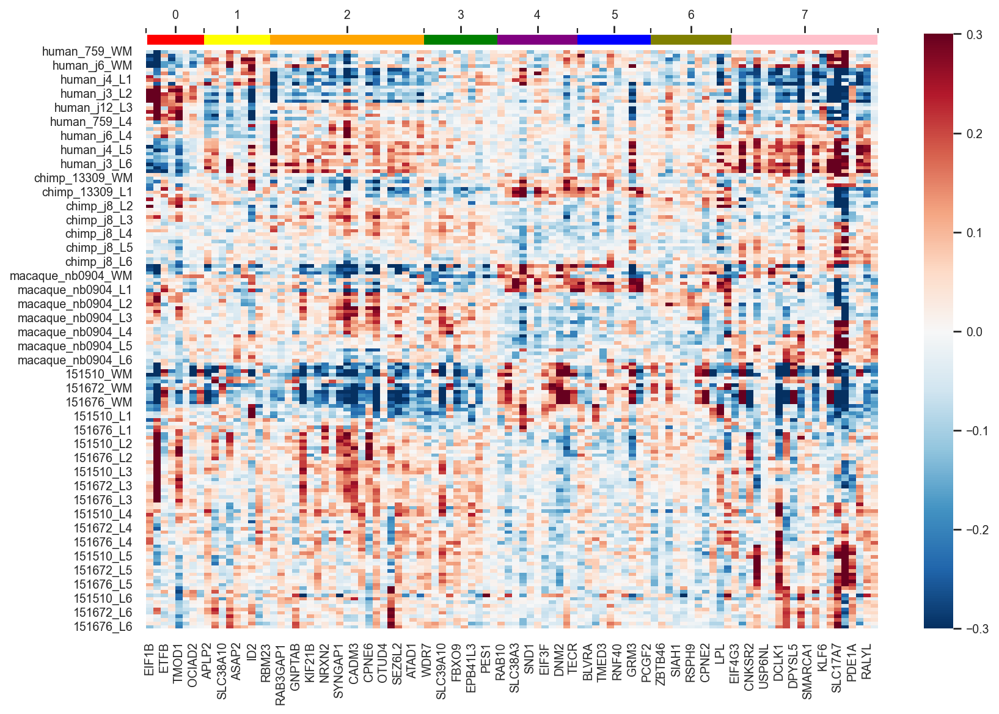

In [121]:
from matplotlib.patches import bbox_artist
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import ticker

fig, ax = plt.subplots(figsize=(12, 8))
sns.heatmap(df_hs[order], ax=ax, cmap="RdBu_r", vmax=0.3, vmin=-0.3, center=0)
divider = make_axes_locatable(ax)
cax = divider.append_axes('top', size='2%', pad=0.05)
cmap = mpl.colors.ListedColormap(colors)

cluster_size = ancova_labels.value_counts().loc[clusters].values
cluster_pos = cluster_size.cumsum()
bounds = [0] + list(cluster_pos)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
fig.colorbar(
    mpl.cm.ScalarMappable(cmap=cmap, norm=norm),
    cax=cax,
    ticks=bounds,
    orientation='horizontal',
    spacing='proportional'
)
cax.xaxis.set_major_locator(ticker.FixedLocator(cluster_pos - cluster_size / 2))
cax.xaxis.set_major_formatter(ticker.FixedFormatter(clusters))
cax.xaxis.tick_top()

## Cluster profiles

In [122]:
df_annotation = df.copy()
df_annotation['layer'] = adata_pb_merged_norm.obs.layer
df_annotation['condition'] = adata_pb_merged_norm.obs.condition

In [123]:
layer_mean = df_annotation.groupby(['condition', 'layer']).mean()
layer_mean.head()

AACS     AAGAB      AAK1      AAMP      AAR2     AARS2  \
condition layer                                                               
chimp     L1    -0.067618  0.006227 -0.005985  0.010675  0.019738 -0.034726   
          L2    -0.122487  0.010087 -0.014733 -0.007032  0.020551  0.048137   
          L3    -0.020618  0.006018 -0.007162 -0.021035 -0.009774 -0.004803   
          L4     0.043216  0.013610 -0.018613  0.018870  0.018458  0.004733   
          L5     0.078047 -0.012527 -0.007441  0.018252 -0.016986 -0.011088   

                    AASDH  AASDHPPT      AATF      AATK  ...    ZNF821  \
condition layer                                          ...             
chimp     L1     0.005711 -0.130370 -0.059011 -0.031169  ... -0.011753   
          L2    -0.007753  0.004583  0.004615 -0.066022  ...  0.037217   
          L3    -0.000870  0.040310 -0.004254 -0.000688  ... -0.034544   
          L4     0.009839  0.054585 -0.000693  0.005145  ...  0.009614   
          L5     0.000763  0.018848  0.007133  0.047609  ... -0.003981   

                   ZNF827     ZNFX1    ZNHIT3     ZNRF1      ZPR1    ZRANB2  \
condition layer                                                               
chimp     L1    -0.004548  0.045154 -0.000948 -0.171594  0.002985 -0.007838   
          L2    -0.113373  0.007102  0.046256 -0.026685 -0.032662 -0.022249   
          L3     0.012458 -0.014462  0.005719  0.055282  0.004219  0.001835   
          L4     0.003257 -0.016048 -0.006171  0.066573  0.003197 -0.001686   
          L5    -0.036758 -0.023658  0.005084  0.045870  0.000959  0.001732   

                  ZSCAN18   ZSCAN21      ZUP1  
condition layer                                
chimp     L1    -0.063586  0.028563 -0.102041  
          L2    -0.049973  0.009392  0.026373  
          L3     0.040223 -0.008613  0.004398  
          L4     0.037789  0.011225  0.003990  
          L5     0.036356 -0.018317  0.016004  

[5 rows x 5300 columns]

In [124]:
# fig, axes = plt.subplots(2, 2,  figsize=(14, 3.5 * 2), gridspec_kw={'hspace': 0.4})
# for gene, ax in zip(layer_mean.columns, axes.flatten()):
#     (
#             layer_mean[gene]
#             .reorder_levels(['layer', 'condition'])
#             .unstack().loc[layers]
#             .plot
#             .line(color=color_dict, ax=ax, marker='.')
#     )
#     ax.grid(False)

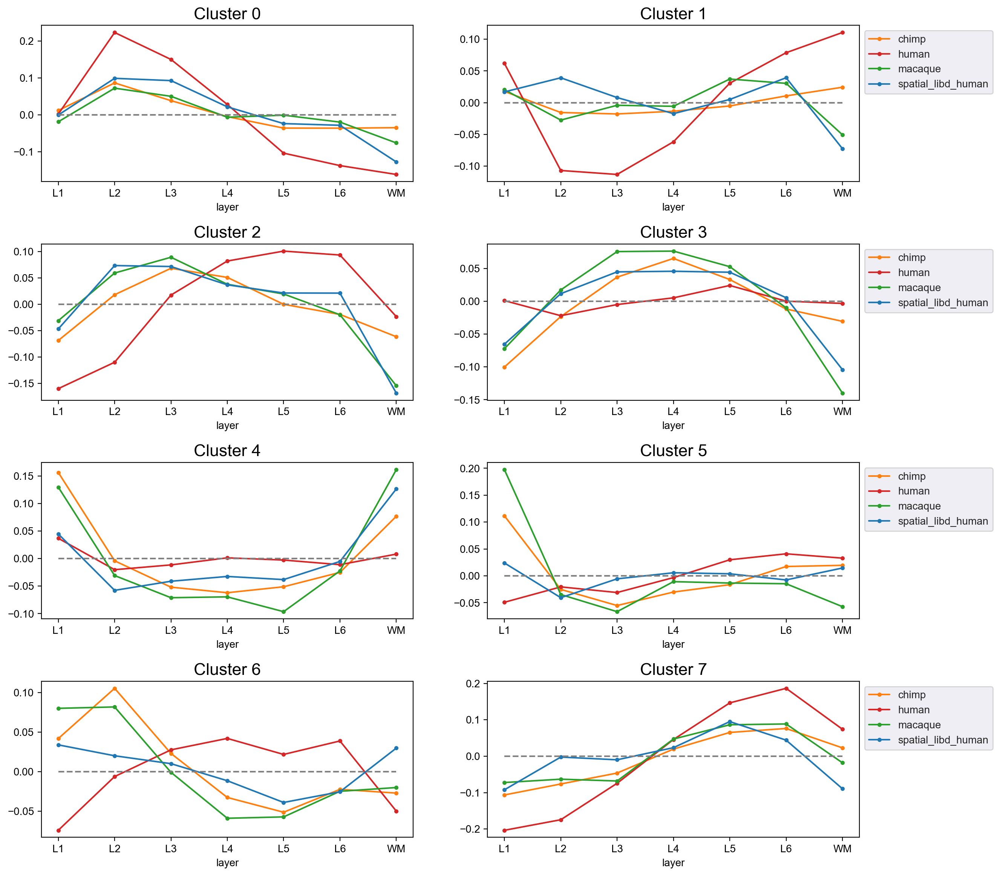

In [125]:
mpl.rcdefaults()
fig, axes = plt.subplots((n_clusters + 1) // 2, 2,  figsize=(14, 3.5 * n_clusters // 2), gridspec_kw={'hspace': 0.4})
sns.set(font_scale=1)

for i, (label, ax) in enumerate(zip(ancova_labels.unique(), axes.flatten())):
    genes = ancova_labels[ancova_labels == label].index.tolist()

    (
        layer_mean[genes]
        .mean(axis=1)
        .reorder_levels(['layer', 'condition'])
        .unstack().loc[layers]
        .plot
        .line(color={'human': 'tab:red', 'chimp': 'tab:orange', 'macaque': 'tab:green', 'spatial_libd_human': 'tab:blue'}, ax=ax, marker='.')
    )
    if i % 2:
        ax.legend(fontsize=10, loc="upper left", bbox_to_anchor=(1,1))
    else:
        ax.get_legend().remove()
    ax.set_title(f'Cluster {label}', fontsize=16)
    ax.grid(False)
    ax.hlines(0, xmin=0, xmax=6, colors='gray', linestyles='dashed')

In [126]:
grid = np.linspace(1, 7, 400)
conditions = ['human', 'chimp', 'macaque', 'spatial_libd_human']
cond_colors = ['tab:red', 'tab:orange', 'tab:green', 'tab:blue']
color_dict = {'human': 'tab:red', 'chimp': 'tab:orange', 'macaque': 'tab:green', 'spatial_libd_human': 'tab:blue'}

In [127]:
df_cont = df_annotation.copy()
df_cont['layer'] = df_cont.layer.map(dict(zip(sorted(df_cont.layer.unique()), range(1, 8)))).astype(int)

In [128]:
from scipy.interpolate import UnivariateSpline

array = np.zeros((grid.size, hs_genes.size))
df_list = []

for specie in conditions:
    for i, gene in enumerate(hs_genes.to_list()):
        #fit spline
        subs_index = df_cont[df_cont.condition == specie].index
        targ_dataset = df_cont.loc[subs_index].copy().sort_values(by='layer')
        x = targ_dataset['layer'].values
        y = targ_dataset[gene].values
        spl = UnivariateSpline(x, y, k=3)
        array[:, i] = spl(grid)
    df_specie = pd.DataFrame(array, columns=hs_genes)
    df_specie['condition'] = specie
    df_list.append(df_specie.copy())
df_spline = pd.concat(df_list)

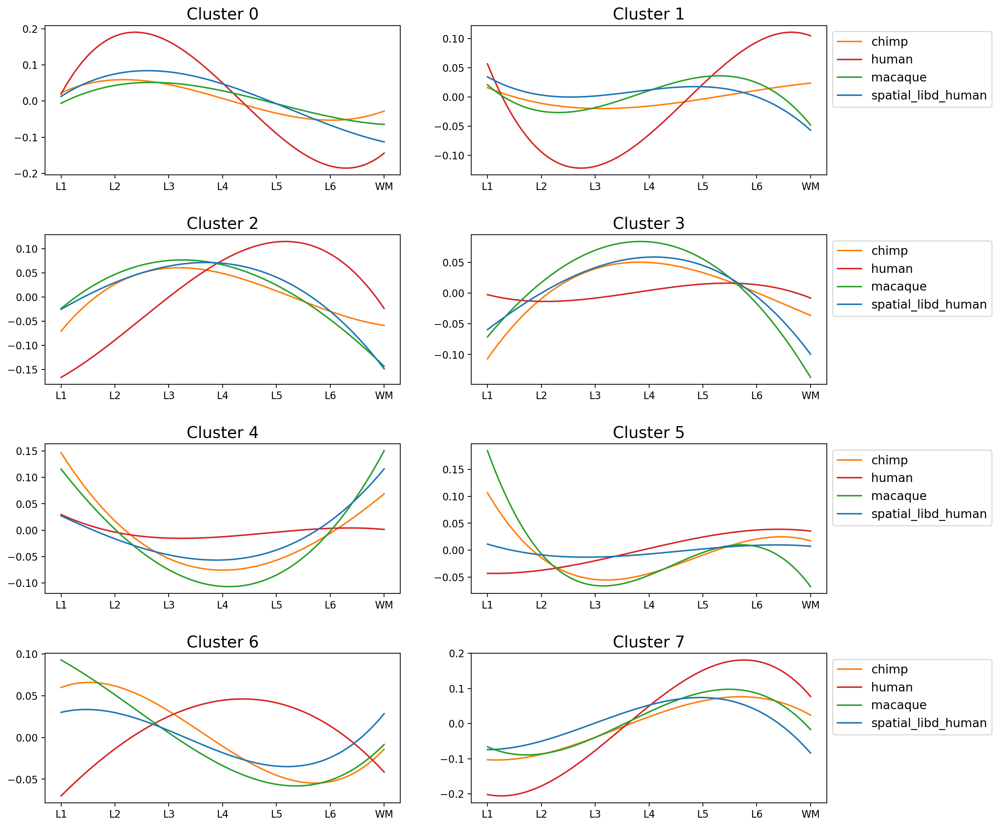

In [129]:
mpl.rcdefaults()
fig, axes = plt.subplots((n_clusters + 1) // 2, 2,  figsize=(14, 3.5 * n_clusters // 2), gridspec_kw={'hspace': 0.4})
for label, ax in zip(ancova_labels.unique(), axes.flatten()):
    genes = ancova_labels[ancova_labels == label].index.tolist()
    # plot the splines
    df_cluster_spline = df_spline[genes].mean(axis=1).to_frame()
    df_cluster_spline['condition'] = df_spline['condition']
    df_cluster_spline = df_cluster_spline.pivot(columns='condition', values=0)
    df_cluster_spline.index = grid
    df_cluster_spline.plot.line(color=color_dict, ax=ax)

    # plot the dots
    # df_layers = layer_mean[genes].mean(axis=1).reorder_levels(['layer', 'condition']).unstack().loc[layers][conditions]
    # df_layers.index = np.arange(1, 8)
    # ax.set_prop_cycle(color=['tab:red', 'tab:orange', 'tab:green'])
    # ax.plot(df_layers, 'o', alpha=0.7)
    # ax.legend(conditions)
    
    
    ax.legend(fontsize=10, loc="upper left", bbox_to_anchor=(1, 1), prop={"size":12})
    ax.xaxis.set_major_locator(ticker.FixedLocator(np.arange(1, 8)))
    ax.xaxis.set_major_formatter(ticker.FixedFormatter(layers))
    
    if label % 2 == 0:
        ax.get_legend().remove()
    ax.set_title(f'Cluster {label}', fontsize=16)
    ax.grid(False)
    #ax.hlines(0, xmin=1, xmax=6, colors='gray', linestyles='dashed')

## All genes

### Human

Text(0.5, 1.0, 'NCAM2')

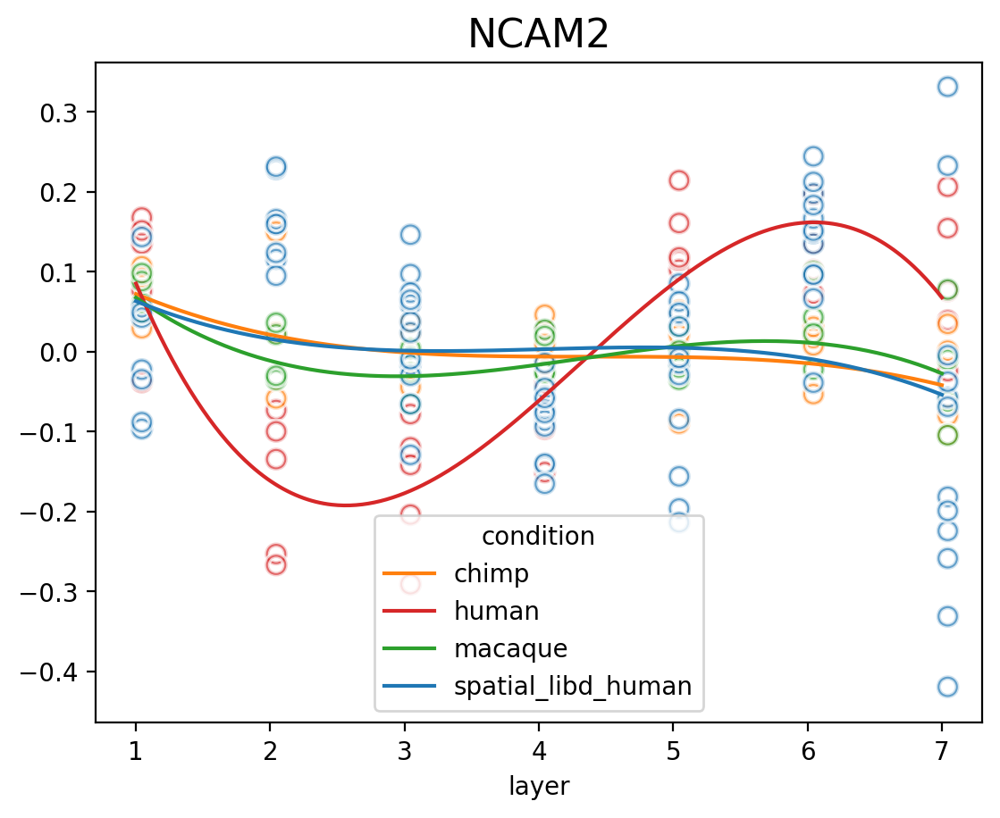

In [130]:
fig, ax = plt.subplots()

gene = 'NCAM2'
df_cluster_spline = df_spline[[gene, 'condition']].copy()
df_cluster_spline = df_cluster_spline.pivot(columns='condition', values=gene)
df_cluster_spline.index = grid
df_cluster_spline.plot.line(color=color_dict, ax=ax)

df_cluster_values = df_cont[[gene, 'condition', 'layer']].copy()
palette = color_dict
sns.scatterplot(df_cont, x='layer', y=gene, hue='condition', palette=palette, ax=ax, legend=False, alpha=0.7, marker="$\circ$", s=200)
ax.set_ylabel('')
ax.set_title(gene, fontsize=16)
#df_cluster_values.plot.scatter(x='layer', y=gene, c='condition', ax=ax, cmap=cmap, colorbar=False, legend=True)
#ax.legend(['human', 'chimp', 'macaque'])

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

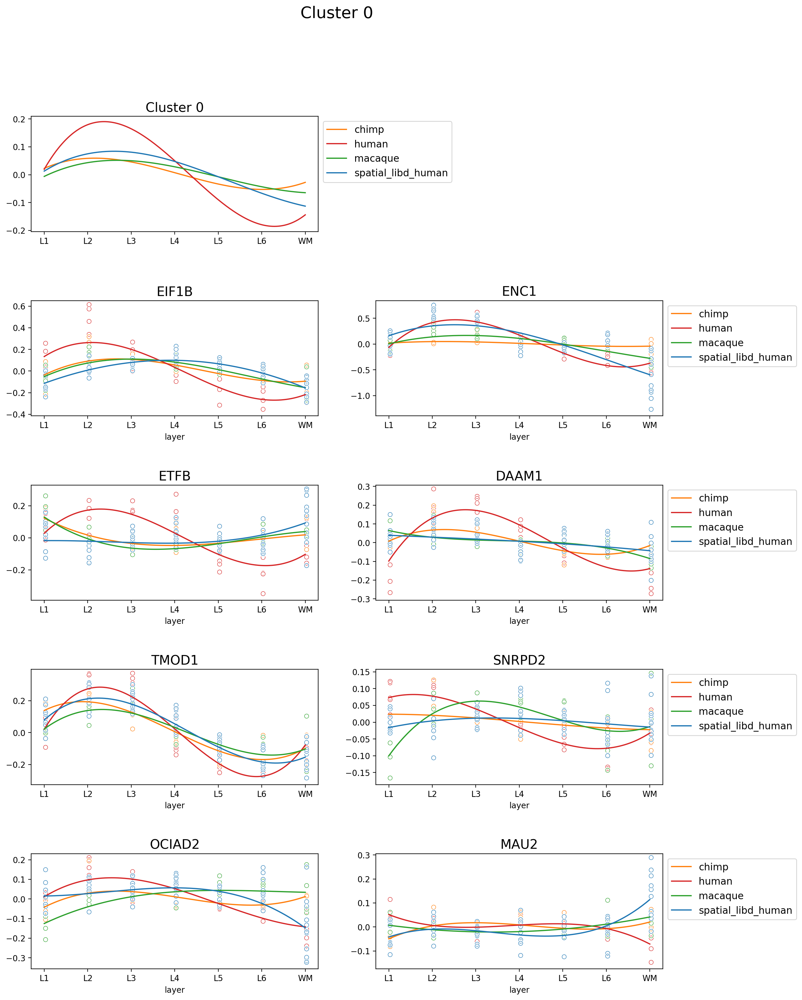

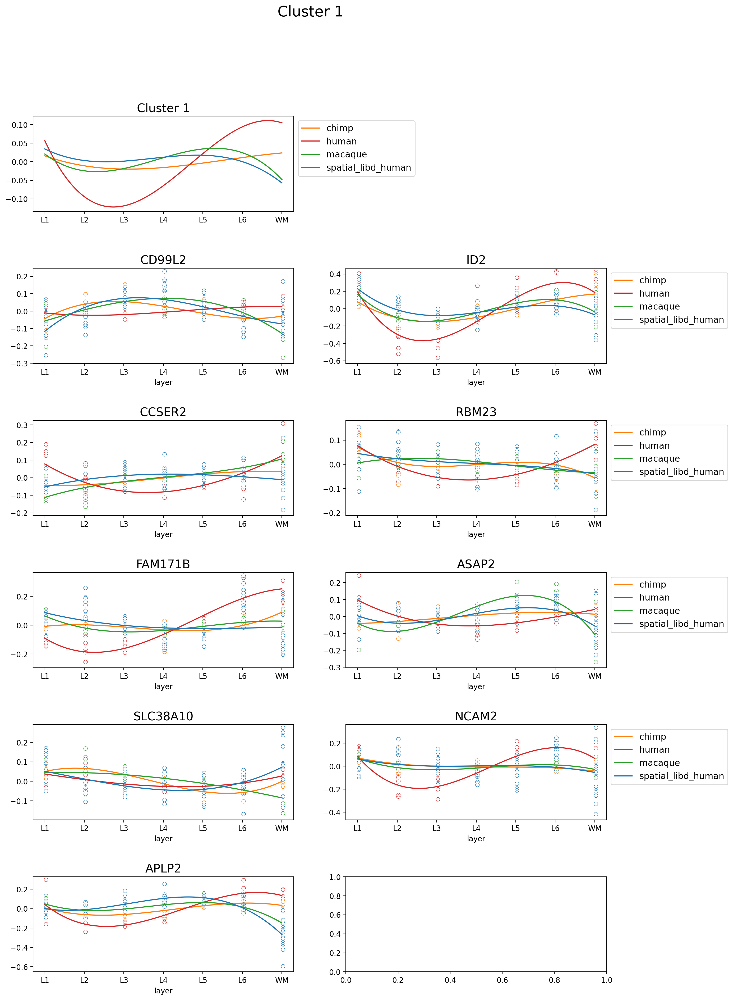

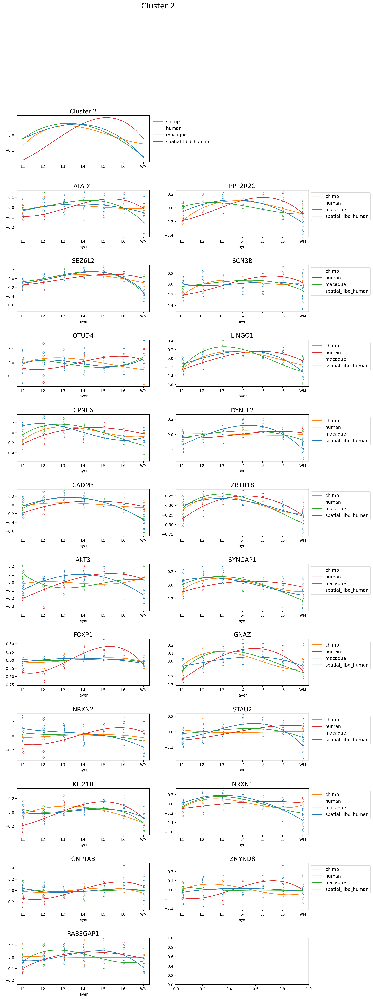

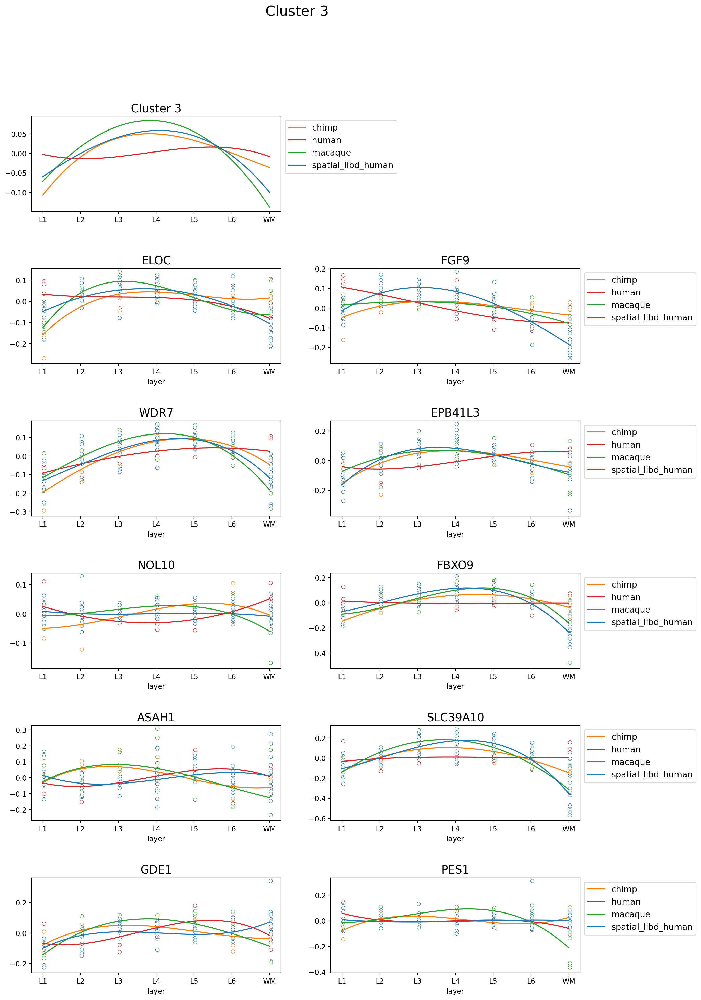

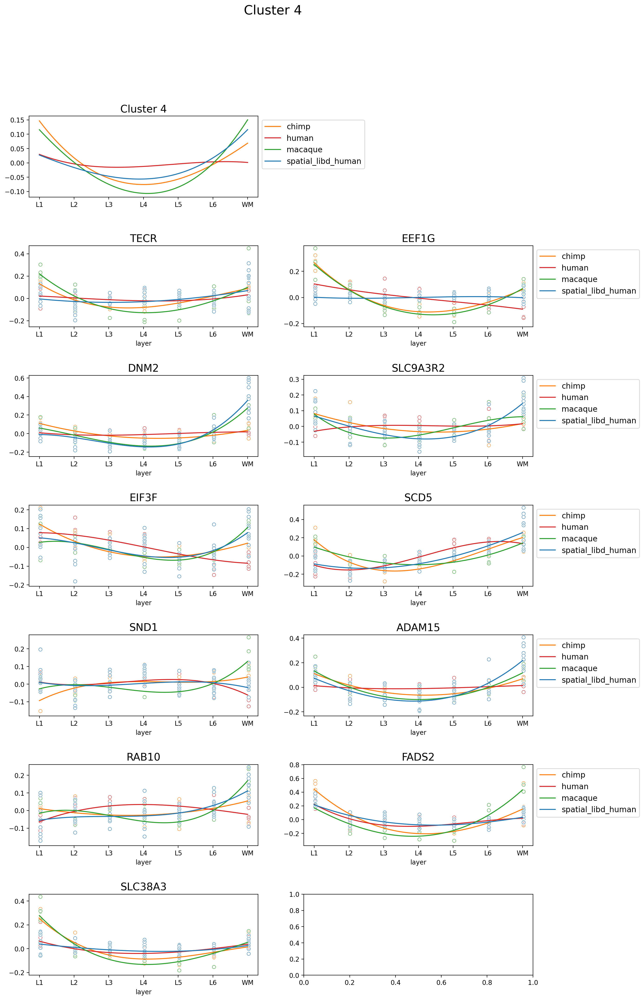

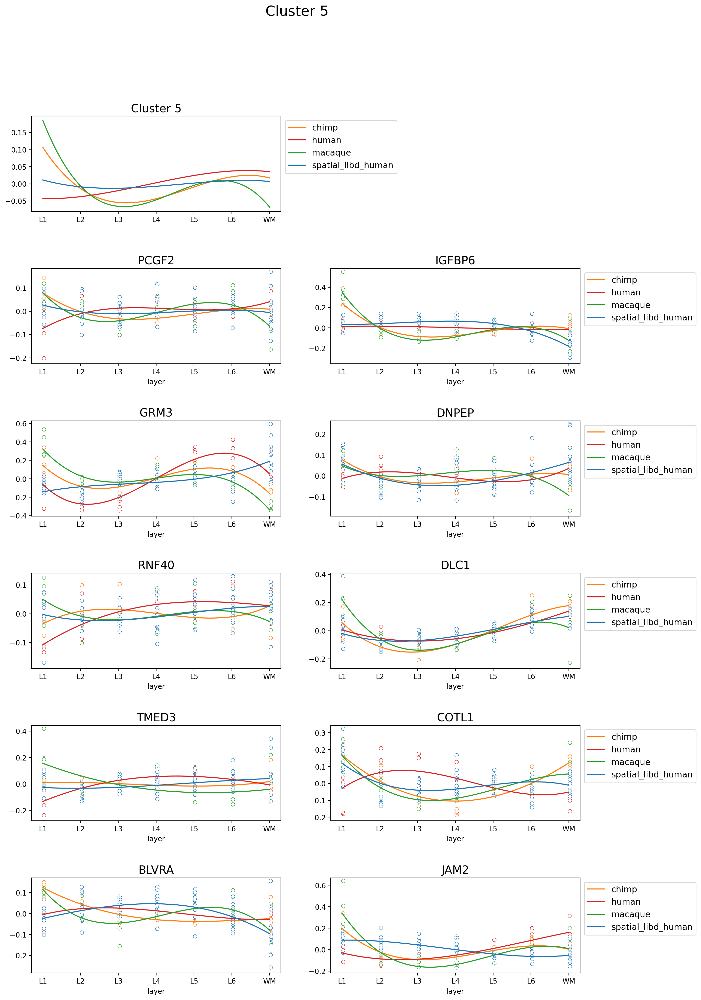

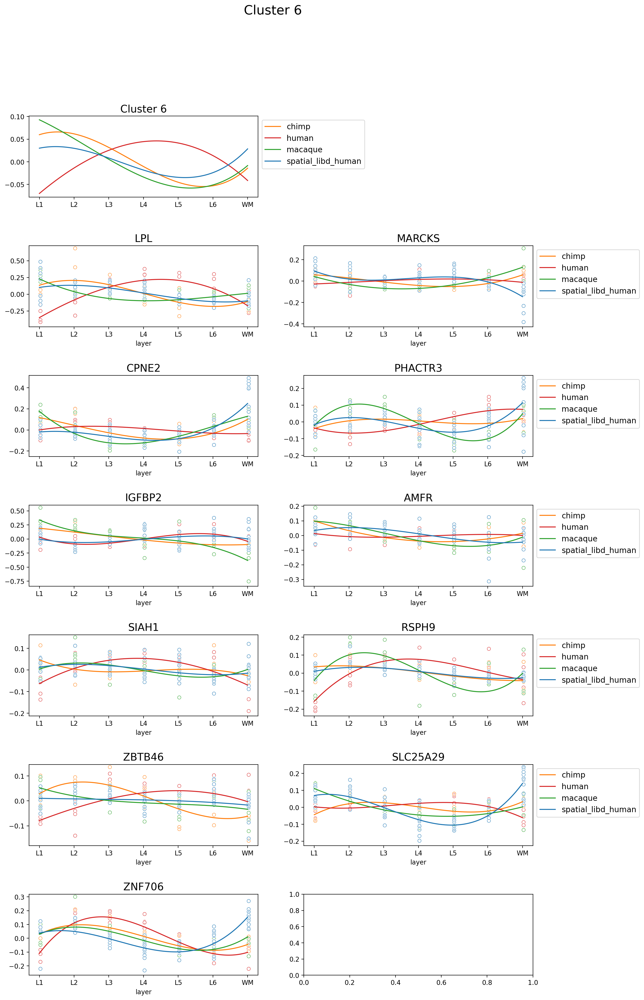

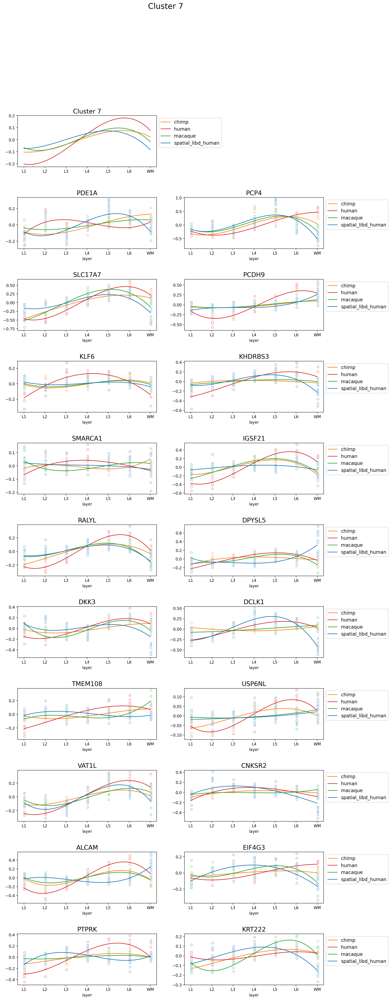

In [131]:
mpl.rcdefaults()

for label in ancova_labels.unique():
    genes = ancova_labels[ancova_labels == label].index.tolist()
    fig, axes = plt.subplots((len(genes) + 3) // 2, 2,  figsize=(14, 3.5 * (len(genes) + 3) // 2), gridspec_kw={'hspace': 0.6})
    fig.suptitle(f'Cluster {label}', fontsize=20)

    ax = axes[0][0]

    df_cluster_spline = df_spline[genes].mean(axis=1).to_frame()
    df_cluster_spline['condition'] = df_spline['condition']
    df_cluster_spline = df_cluster_spline.pivot(columns='condition', values=0)
    df_cluster_spline.index = grid
    df_cluster_spline.plot.line(color=color_dict, ax=ax)

    # plot the dots
    # df_layers = layer_mean[genes].mean(axis=1).reorder_levels(['layer', 'condition']).unstack().loc[layers][conditions]
    # df_layers.index = np.arange(1, 8)
    # ax.set_prop_cycle(color=['tab:red', 'tab:orange', 'tab:green'])
    # ax.plot(df_layers, 'o', alpha=0.7)
    # ax.legend(conditions)
    
    
    ax.legend(fontsize=10, loc="upper left", bbox_to_anchor=(1, 1), prop={"size":12})
    ax.xaxis.set_major_locator(ticker.FixedLocator(np.arange(1, 8)))
    ax.xaxis.set_major_formatter(ticker.FixedFormatter(layers))
    
    ax.set_title(f'Cluster {label}', fontsize=16)
    ax.grid(False)
    #ax.hlines(0, xmin=0, xmax=6, colors='gray', linestyles='dashed')
    fig.delaxes(axes[0][1])
    
    
    for i, (gene, ax) in tqdm(enumerate(zip(genes, axes.flatten()[2:]))):
        df_cluster_spline = df_spline[[gene, 'condition']].copy()
        df_cluster_spline = df_cluster_spline.pivot(columns='condition', values=gene)
        df_cluster_spline.index = grid
        df_cluster_spline.plot.line(color=color_dict, ax=ax)
        
        df_cluster_values = df_cont[[gene, 'condition', 'layer']].copy()
        palette = color_dict
        sns.scatterplot(df_cont, x='layer', y=gene, hue='condition', palette=palette, ax=ax, legend=False, alpha=1, marker="$\circ$", s=100)
        ax.set_ylabel('')
        
        
        ax.legend(fontsize=10, loc="upper left", bbox_to_anchor=(1, 1), prop={"size":12})
        ax.xaxis.set_major_locator(ticker.FixedLocator(np.arange(1, 8)))
        ax.xaxis.set_major_formatter(ticker.FixedFormatter(layers))

        if i % 2 == 0:
            ax.get_legend().remove()
    
        ax.set_title(f'{gene}', fontsize=16)
        ax.grid(False)
        #ax.hlines(0, xmin=0, xmax=6, colors='gray', linestyles='dashed')
    plt.savefig(f'results/adult_human_pics/hs_genes_splines_{pval_tr}_{n_clusters}_{label}.pdf')

In [132]:
import glob
from pypdf import PdfMerger

pdf_files = glob.glob(f'results/adult_human_pics/hs_genes_splines_{pval_tr}_{n_clusters}*')
merger = PdfMerger()
for pdf in pdf_files:
    merger.append(pdf)
merger.write(f"results/adult_human_pics/hs_genes_splines_{pval_tr}_{n_clusters}_all.pdf")
merger.close()

for file in pdf_files:
    os.remove(file.replace('\\', '/'))

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

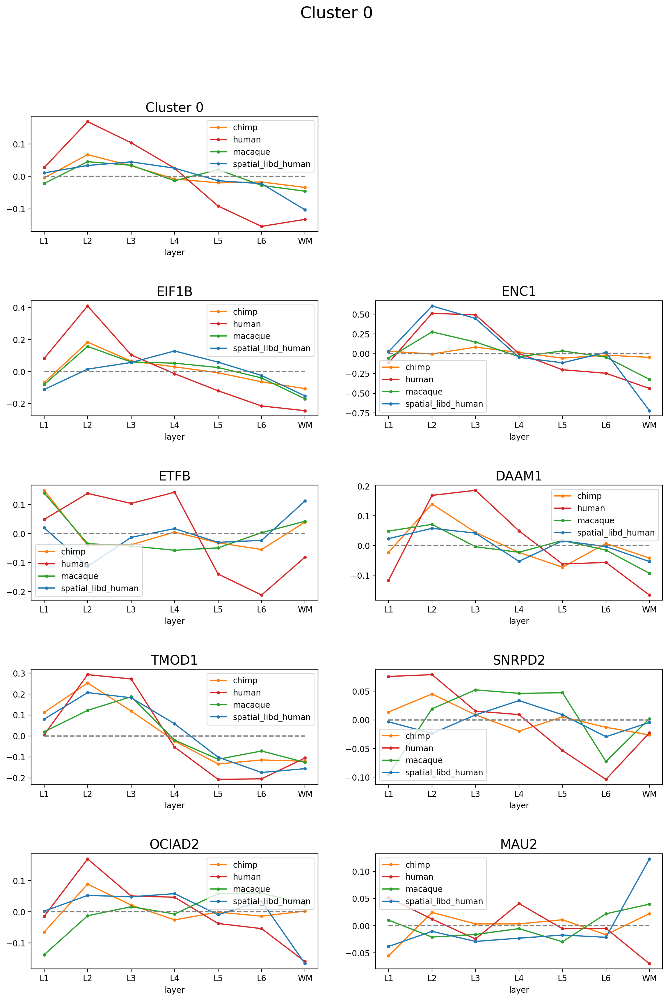

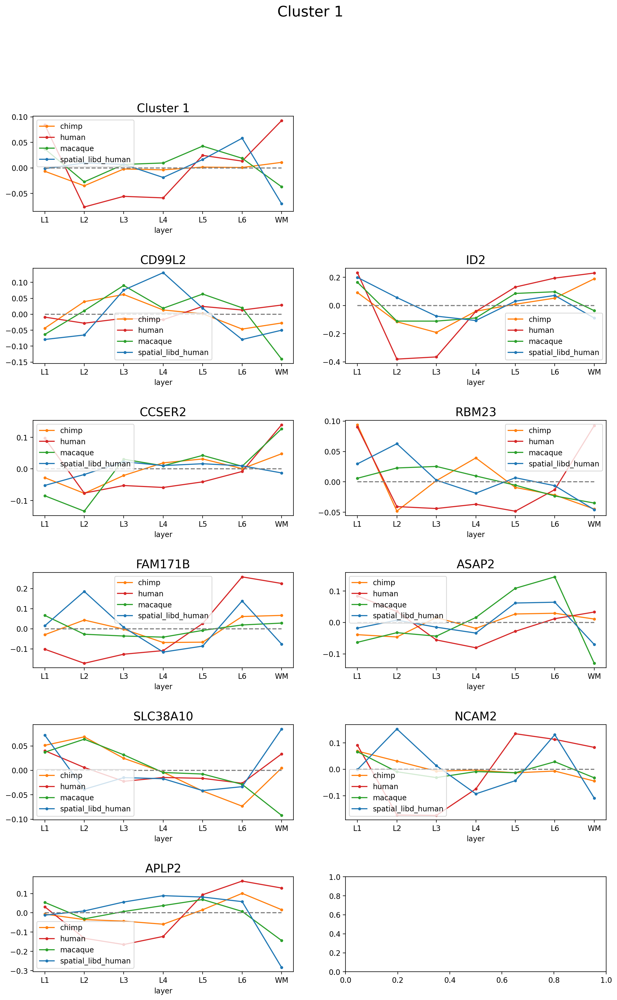

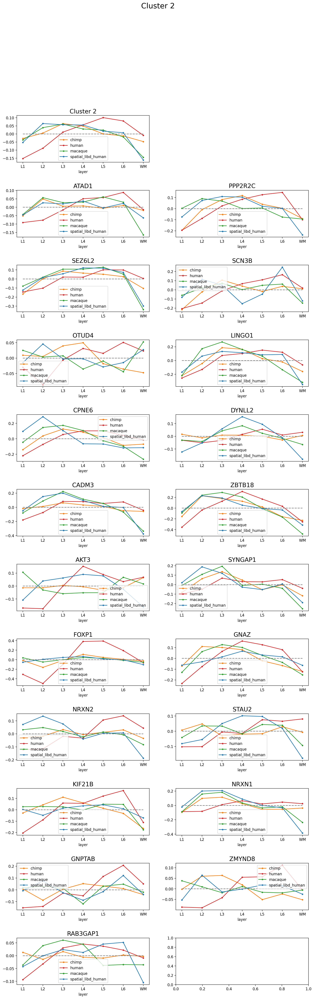

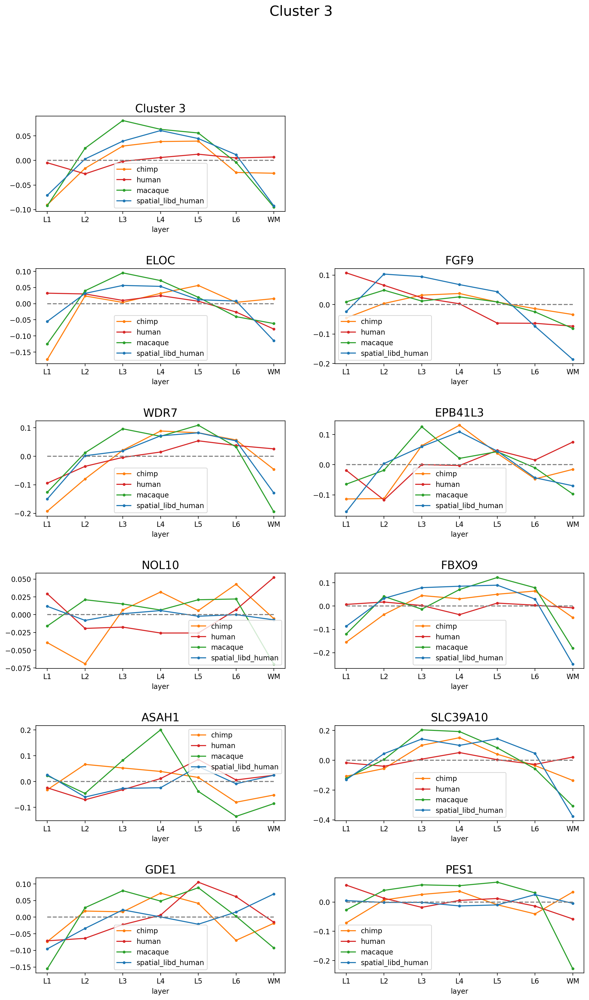

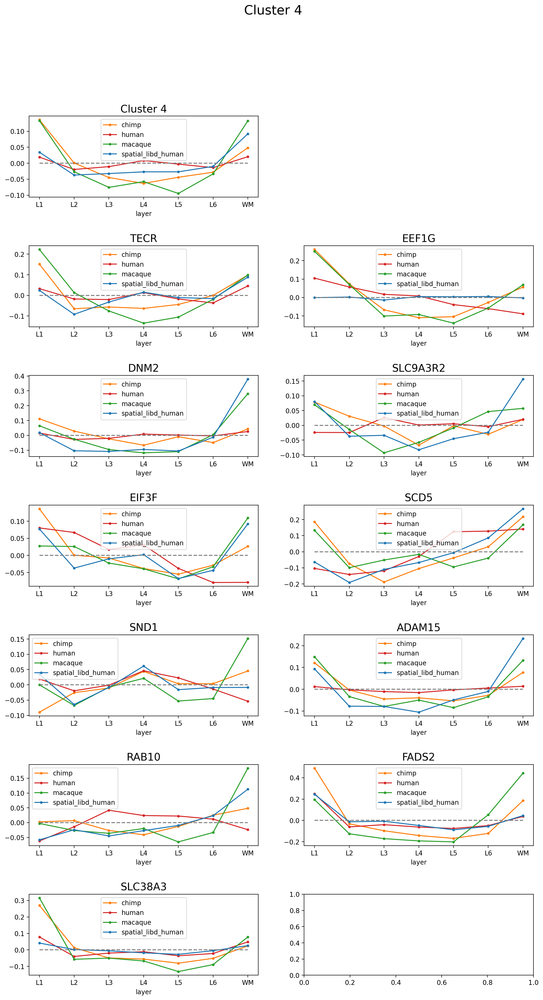

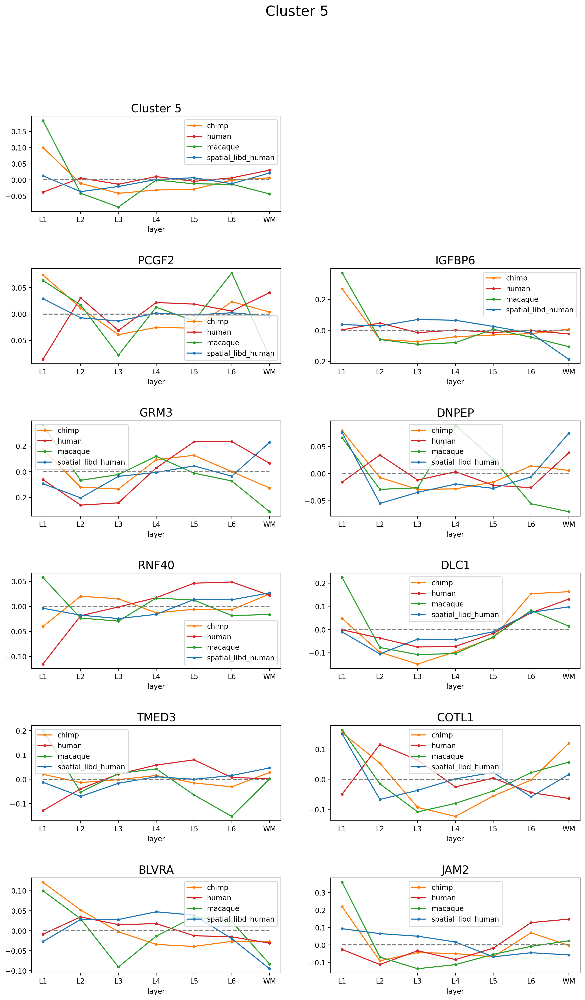

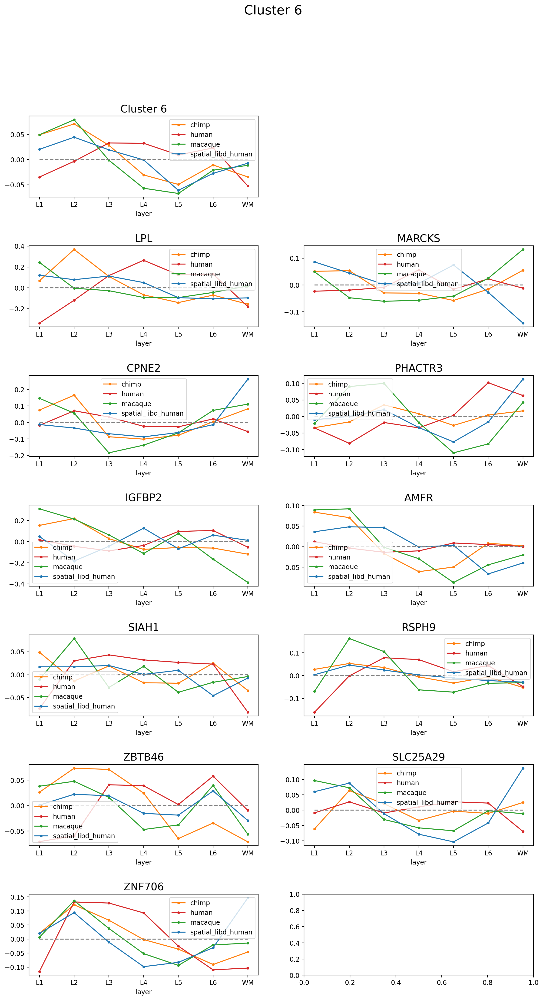

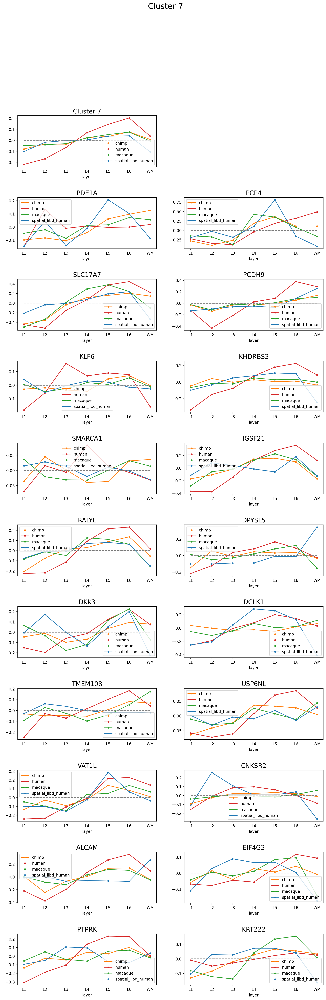

In [133]:
mpl.rcdefaults()

for label in ancova_labels.unique():
    genes = ancova_labels[ancova_labels == label].index.tolist()
    fig, axes = plt.subplots((len(genes) + 3) // 2, 2,  figsize=(14, 3.5 * (len(genes) + 3) // 2), gridspec_kw={'hspace': 0.6})
    fig.suptitle(f'Cluster {label}', fontsize=20)

    ax = axes[0][0]

    (
        layer_mean[genes]
        .median(axis=1)
        .reorder_levels(['layer', 'condition'])
        .unstack().loc[layers]
        .plot
        .line(color=color_dict, ax=ax, marker='.')
    )
    ax.legend(fontsize=10)
    ax.set_title(f'Cluster {label}', fontsize=16)
    ax.grid(False)
    ax.hlines(0, xmin=0, xmax=6, colors='gray', linestyles='dashed')
    fig.delaxes(axes[0][1])
    
    
    for gene, ax in tqdm(list(zip(genes, axes.flatten()[2:]))):
        (
            layer_mean[gene]
            .reorder_levels(['layer', 'condition'])
            .unstack().loc[layers]
            .plot
            .line(color=color_dict, ax=ax, marker='.')
        )
        ax.legend(fontsize=10)
        ax.set_title(f'{gene}', fontsize=16)
        ax.grid(False)
        ax.hlines(0, xmin=0, xmax=6, colors='gray', linestyles='dashed')
    plt.savefig(f'results/adult_human_pics/hs_genes_cluster_{pval_tr}_{n_clusters}_{label}.pdf')

In [134]:
import glob
from pypdf import PdfMerger

pdf_files = glob.glob(f'results/adult_human_pics/hs_genes_cluster_{pval_tr}_{n_clusters}*')
merger = PdfMerger()
for pdf in pdf_files:
    merger.append(pdf)
merger.write(f"results/adult_human_pics/hs_genes_cluster_{pval_tr}_{n_clusters}_all.pdf")
merger.close()

for file in pdf_files:
    os.remove(file.replace('\\', '/'))

## Levels of genes

In [88]:
hs_genes

Index(['ADAM15', 'AKT3', 'ALCAM', 'AMFR', 'APLP2', 'ASAH1', 'ASAP2', 'ATAD1',
       'BLVRA', 'CADM3', 'CCSER2', 'CD99L2', 'CNKSR2', 'COTL1', 'CPNE2',
       'CPNE6', 'DAAM1', 'DCLK1', 'DKK3', 'DLC1', 'DNM2', 'DNPEP', 'DPYSL5',
       'DYNLL2', 'EEF1G', 'EIF1B', 'EIF3F', 'EIF4G3', 'ELOC', 'ENC1',
       'EPB41L3', 'ETFB', 'FADS2', 'FAM171B', 'FBXO9', 'FGF9', 'FOXP1', 'GDE1',
       'GNAZ', 'GNPTAB', 'GRM3', 'ID2', 'IGFBP2', 'IGFBP6', 'IGSF21', 'JAM2',
       'KHDRBS3', 'KIF21B', 'KLF6', 'KRT222', 'LINGO1', 'LPL', 'MARCKS',
       'MAU2', 'NCAM2', 'NOL10', 'NRXN1', 'NRXN2', 'OCIAD2', 'OTUD4', 'PCDH9',
       'PCGF2', 'PCP4', 'PDE1A', 'PES1', 'PHACTR3', 'PPP2R2C', 'PTPRK',
       'RAB10', 'RAB3GAP1', 'RALYL', 'RBM23', 'RNF40', 'RSPH9', 'SCD5',
       'SCN3B', 'SEZ6L2', 'SIAH1', 'SLC17A7', 'SLC25A29', 'SLC38A10',
       'SLC38A3', 'SLC39A10', 'SLC9A3R2', 'SMARCA1', 'SND1', 'SNRPD2', 'STAU2',
       'SYNGAP1', 'TECR', 'TMED3', 'TMEM108', 'TMOD1', 'USP6NL', 'VAT1L',
       'WDR7', 'ZBTB18',

In [89]:
pretty_genes = ['PHACTR3', 'MARCKS', 'LPL', 'COTL1', 'GRM3', 'SCD5', 'EIF3F', 'EEF1G', 'NOL10', 'RAB3GAP1', 'ZMYND8', 'GNPTAB','NRXN1',
                'NRXN2', 'KIF21B', 'STAU2', 'GNAZ', 'FOXP1', 'AKT3', 'SYNGAP1', 'ZBTB18', 'DYNLL2', 'CPNE6', 'OTUD4','LINGO1', 'SCN3B',
                'ATAD1', 'PPP2R2C', 'APLP2', 'NCAM2', 'SLC38A10', 'ASAP2', 'FAM171B', 'RBM23', 'ID2', 'ETFB', 'ENC1', 'EIF1B']

In [90]:
pb_dir_path = '../../data/pseudobulks/'

In [91]:
adata_pb = sc.read_h5ad(pb_dir_path + 'pb_mammals_filtered.h5ad')
adata_pb

FileNotFoundError: [Errno 2] Unable to open file (unable to open file: name = '../../data/pseudobulks/pb_mammals_filtered.h5ad', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

In [ ]:
sc.pp.normalize_total(adata_pb, target_sum=1e4)
sc.pp.log1p(adata_pb)

In [ ]:
df_pb = pd.DataFrame(adata_pb.X, index=adata_pb.obs_names, columns=adata_pb.var_names)

In [ ]:
df_pb = df_pb.loc[sample_order['all']]
#df_hs = df[hs_genes].copy()

In [ ]:
df_annotation_pb = df_pb.copy()
df_annotation_pb['layer'] = adata_pb.obs.layer
df_annotation_pb['condition'] = adata_pb.obs.condition

In [ ]:
sns.histplot(df_annotation_pb[df_annotation_pb.condition == 'human'].iloc[:, :-2].mean(axis=0))

In [ ]:
layer_mean_pb = df_annotation_pb.groupby(['condition', 'layer']).mean()
layer_mean_pb.head()

In [ ]:
mpl.rcdefaults()

#gene_labels = ancova_labels.loc[pretty_genes]
gene_labels = ancova_labels


for label in gene_labels.unique():
    genes = gene_labels[gene_labels == label].index.tolist()
    fig, axes = plt.subplots((len(genes) + 1), 2,  figsize=(14, 3.5 * (len(genes) + 1)), gridspec_kw={'hspace': 0.6})
    fig.suptitle(f'Cluster {label}', fontsize=20)

    ax = axes[0][0]

    (
        layer_mean[genes]
        .median(axis=1)
        .reorder_levels(['layer', 'condition'])
        .unstack().loc[layers]
        .plot
        .line(color=color_dict, ax=ax, marker='.')
    )
    ax.legend(fontsize=10)
    ax.set_title(f'Cluster {label}', fontsize=16)
    ax.grid(False)
    #ax.hlines(0, xmin=0, xmax=6, colors='gray', linestyles='dashed')
    fig.delaxes(axes[0][1])
    
    
    for i, gene in tqdm(enumerate(genes)):
        (
            layer_mean[gene]
            .reorder_levels(['layer', 'condition'])
            .unstack().loc[layers]
            .plot
            .line(color=color_dict, ax=axes[i + 1, 0], marker='.')
        )
        axes[i + 1, 0].legend(fontsize=10)
        axes[i + 1, 0].set_title(f'{gene}', fontsize=16)
        axes[i + 1, 0].grid(False)
        axes[i + 1, 0].hlines(0, xmin=0, xmax=6, colors='gray', linestyles='dashed')

        (
            layer_mean_pb[gene]
            .reorder_levels(['layer', 'condition'])
            .unstack().loc[layers]
            .plot
            .line(color=color_dict, ax=axes[i + 1, 1], marker='.')
        )
        axes[i + 1, 1].legend(fontsize=10)
        axes[i + 1, 1].set_title(f'{gene} Log(CP10K)', fontsize=16)
        axes[i + 1, 1].grid(False)
        #axes[i + 1, 1].hlines(0, xmin=0, xmax=6, colors='gray', linestyles='dashed')
    #plt.savefig(f'results/adult_human_pics/hs_genes_levels_{pval_tr}_cluster_{n_clusters}_{label}.pdf')

In [ ]:
import glob
from pypdf import PdfMerger

pdf_files = glob.glob(f'results/adult_human_pics/hs_genes_levels_{pval_tr}_cluster_{n_clusters}*')
merger = PdfMerger()
for pdf in pdf_files:
    merger.append(pdf)
merger.write(f"results/adult_human_pics/hs_genes_levels_{pval_tr}_cluster_{n_clusters}_all.pdf")
merger.close()

for file in pdf_files:
    os.remove(file.replace('\\', '/'))

In [ ]:
df_cont_pb = df_annotation_pb.copy()
df_cont_pb['layer'] = df_cont_pb.layer.map(dict(zip(sorted(df_cont_pb.layer.unique()), range(1, 8)))).astype(int)

In [ ]:
from scipy.interpolate import UnivariateSpline

array = np.zeros((grid.size, hs_genes.size))
df_list = []

for specie in conditions:
    for i, gene in enumerate(hs_genes.to_list()):
        #fit spline
        subs_index = df_cont_pb[df_cont_pb.condition == specie].index
        targ_dataset = df_cont_pb.loc[subs_index].copy().sort_values(by='layer')
        x = targ_dataset['layer'].values
        y = targ_dataset[gene].values
        spl = UnivariateSpline(x, y, k=3)
        array[:, i] = spl(grid)
    df_specie = pd.DataFrame(array, columns=hs_genes)
    df_specie['condition'] = specie
    df_list.append(df_specie.copy())
df_spline_pb = pd.concat(df_list)

In [ ]:
mpl.rcdefaults()
gene_labels = ancova_labels


for label in gene_labels.unique():
    genes = gene_labels[gene_labels == label].index.tolist()
    fig, axes = plt.subplots((len(genes) + 1), 2,  figsize=(14, 3.5 * (len(genes) + 1)), gridspec_kw={'hspace': 0.6})
    fig.suptitle(f'Cluster {label}', fontsize=20)

    ax = axes[0][0]

    df_cluster_spline = df_spline[genes].mean(axis=1).to_frame()
    df_cluster_spline['condition'] = df_spline['condition']
    df_cluster_spline = df_cluster_spline.pivot(columns='condition', values=0)
    df_cluster_spline.index = grid
    df_cluster_spline.plot.line(color=color_dict, ax=ax)

    # plot the dots
    # df_layers = layer_mean[genes].mean(axis=1).reorder_levels(['layer', 'condition']).unstack().loc[layers][conditions]
    # df_layers.index = np.arange(1, 8)
    # ax.set_prop_cycle(color=['tab:red', 'tab:orange', 'tab:green'])
    # ax.plot(df_layers, 'o', alpha=0.7)
    # ax.legend(conditions)
    
    
    ax.legend(fontsize=10, loc="upper left", bbox_to_anchor=(1, 1), prop={"size":12})
    ax.xaxis.set_major_locator(ticker.FixedLocator(np.arange(1, 8)))
    ax.xaxis.set_major_formatter(ticker.FixedFormatter(layers))
    ax.set_title(f'Cluster {label}', fontsize=16)
    ax.grid(False)
    #ax.hlines(0, xmin=0, xmax=6, colors='gray', linestyles='dashed')
    fig.delaxes(axes[0][1])
    
    
    for i, gene in tqdm(enumerate(genes)):
        df_cluster_spline = df_spline[[gene, 'condition']].copy()
        df_cluster_spline = df_cluster_spline.pivot(columns='condition', values=gene)
        df_cluster_spline.index = grid
        df_cluster_spline.plot.line(color=color_dict, ax=axes[i + 1, 0])
        
        df_cluster_values = df_cont[[gene, 'condition', 'layer']].copy()
        palette = color_dict
        sns.scatterplot(df_cont, x='layer', y=gene, hue='condition', palette=palette, ax=axes[i + 1, 0], legend=False, alpha=1, marker="$\circ$", s=100)
        axes[i + 1, 0].set_ylabel('')
        
        
        axes[i + 1, 0].legend(fontsize=10, loc="upper left", bbox_to_anchor=(1, 1), prop={"size":12})
        axes[i + 1, 0].set_title(f'{gene}', fontsize=16)
        axes[i + 1, 0].xaxis.set_major_locator(ticker.FixedLocator(np.arange(1, 8)))
        axes[i + 1, 0].xaxis.set_major_formatter(ticker.FixedFormatter(layers))
        axes[i + 1, 0].get_legend().remove()


        df_cluster_spline = df_spline_pb[[gene, 'condition']].copy()
        df_cluster_spline = df_cluster_spline.pivot(columns='condition', values=gene)
        df_cluster_spline.index = grid
        df_cluster_spline.plot.line(color=color_dict, ax=axes[i + 1, 1])
        
        df_cluster_values = df_cont_pb[[gene, 'condition', 'layer']].copy()
        palette = color_dict
        sns.scatterplot(df_cont_pb, x='layer', y=gene, hue='condition', palette=palette, ax=axes[i + 1, 1], legend=False, alpha=1, marker="$\circ$", s=100)
        axes[i + 1, 1].set_ylabel('')
        
        
        axes[i + 1, 1].legend(fontsize=10, loc="upper left", bbox_to_anchor=(1, 1), prop={"size":10})
        axes[i + 1, 1].set_title(f'{gene} Log(CP10K)', fontsize=16)
        axes[i + 1, 1].xaxis.set_major_locator(ticker.FixedLocator(np.arange(1, 8)))
        axes[i + 1, 1].xaxis.set_major_formatter(ticker.FixedFormatter(layers))
        
        #axes[i + 1, 1].hlines(0, xmin=0, xmax=6, colors='gray', linestyles='dashed')
    #plt.savefig(f'results/adult_human_pics/hs_genes_levels_splines_{pval_tr}_cluster_{n_clusters}_{label}.pdf')

In [ ]:
# import glob
# from pypdf import PdfMerger

# pdf_files = glob.glob(f'results/adult_human_pics/hs_genes_levels_splines_{pval_tr}_cluster_{n_clusters}*')
# merger = PdfMerger()
# for pdf in pdf_files:
#     merger.append(pdf)
# merger.write(f"results/adult_human_pics/hs_genes_levels_splines_{pval_tr}_cluster_{n_clusters}_all.pdf")
# merger.close()

# for file in pdf_files:
#     os.remove(file.replace('\\', '/'))

# Slides